# Annotations using clustering for cells for skin_s1

In [1]:
slide_id = "skin_s1"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_skin_s1.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 33606, 19058), (3, 16803, 9529)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (90106, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (90106, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (90106, 377)
      └── 'table_nuclei': AnnData (90106, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 90106 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region
0,aaaaaaaa-1,18,1,0,0,0,19,407.264234,42.627502,cell_labels
1,aaaaaaab-1,26,0,0,0,0,26,113.477660,42.492033,cell_labels
2,aaaaaaac-1,26,0,0,0,0,26,151.725006,78.120315,cell_labels
3,aaaaaaad-1,16,0,0,0,0,16,66.063596,22.713595,cell_labels
4,aaaaaaae-1,9,0,0,0,0,9,114.471098,24.565001,cell_labels
...,...,...,...,...,...,...,...,...,...,...
90101,aaabfppf-1,17,0,0,0,0,17,73.153128,36.395939,cell_labels
90102,aaabfppg-1,23,0,0,0,0,23,318.983762,10.566563,cell_labels
90103,aaabfpph-1,36,0,0,0,0,36,432.822672,19.868751,cell_labels
90104,aaabfppi-1,7,0,0,0,0,7,86.564534,15.624063,cell_labels


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
ABCC11,ENSG00000121270,Gene Expression,Unknown
ACE2,ENSG00000130234,Gene Expression,Unknown
ACKR1,ENSG00000213088,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
ACTG2,ENSG00000163017,Gene Expression,Unknown
...,...,...,...
UPK3B,ENSG00000243566,Gene Expression,Unknown
VCAN,ENSG00000038427,Gene Expression,Unknown
VSIG4,ENSG00000155659,Gene Expression,Unknown
VWA5A,ENSG00000110002,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 27397 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,39.940594,cDC2,16,0,0,0,0,Epithelial,Keratinocyte,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,68.861777,Treg,14,2,2,2,2,Epithelial,Proliferating_basal_keratinocyte,normal_cell
aaaaaaaf-1,nucleus_boundaries,morpho,aaaaaaaf-1,48.522513,Venous EC,13,0,0,3,0,Epithelial,Keratinocyte,normal_cell
aaaaaaag-1,nucleus_boundaries,morpho,aaaaaaag-1,27.160800,Granular keratinocyte,13,0,0,0,0,Epithelial,Keratinocyte,normal_cell
aaaaaaah-1,nucleus_boundaries,morpho,aaaaaaah-1,67.373418,Myofibroblast,34,1,9,1,1,Epithelial,Basal_keatinocyte,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaabfppa-1,nucleus_boundaries,morpho,aaabfppa-1,28.537759,FGFBP2 fibroblast,16,0,0,0,0,Epithelial,Keratinocyte,normal_cell
aaabfppb-1,nucleus_boundaries,morpho,aaabfppb-1,27.004104,Tip EC,14,1,1,1,1,Epithelial,Basal_keatinocyte,normal_cell
aaabfppc-1,nucleus_boundaries,morpho,aaabfppc-1,41.884627,WISP2 fibroblast,20,0,6,11,0,Epithelial,Keratinocyte,normal_cell
aaabfppd-1,nucleus_boundaries,morpho,aaabfppd-1,26.891084,Venous EC,13,0,0,0,0,Epithelial,Keratinocyte,normal_cell


In [9]:
adata_nuclei.var

,mean,std
ABCC11,0.026934,0.408482
ACE2,0.059011,0.605327
ACKR1,0.127511,0.902642
ACTA2,0.367109,1.544518
ACTG2,0.585543,1.897862
...,...,...
UnassignedCodeword_0499,0.000480,0.056181
VCAN,0.290820,1.371785
VSIG4,0.064502,0.636400
VWA5A,0.599416,1.851526


## 2. Preprocessing

<Axes: >

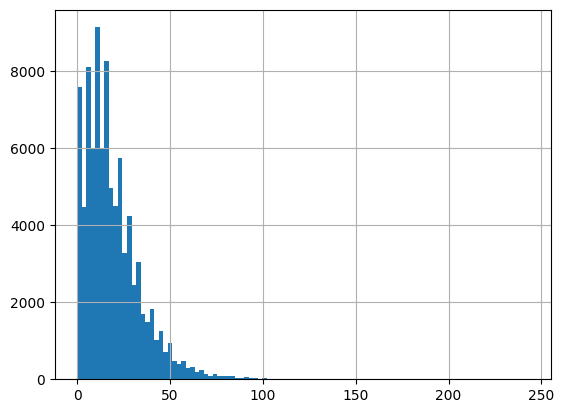

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

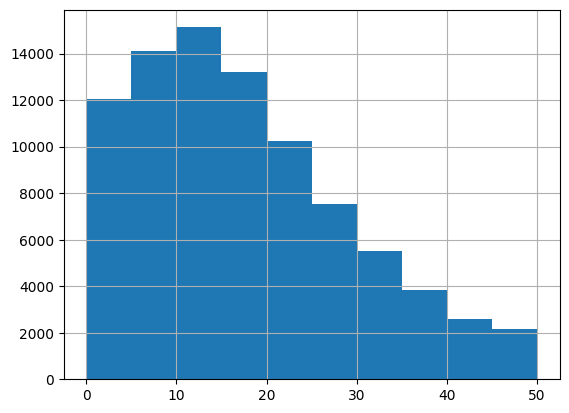

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 54466
Percentage of cells with less than 20 transcripts: 60.45%
-----
Number of cells with less than 15 transcripts: 41264
Percentage of cells with less than 15 transcripts: 45.79%
-----
Number of cells with less than 10 transcripts: 26135
Percentage of cells with less than 10 transcripts: 29.0%
-----
Number total of cells: 90106


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

60979


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


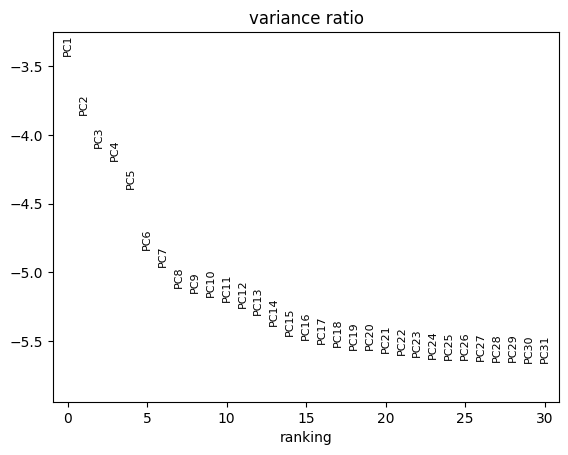

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 60979 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_2243/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


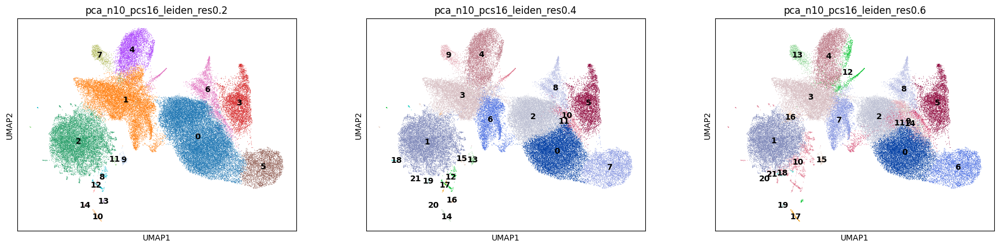

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].unique()

['5', '0', '3', '6', '1', ..., '11', '7', '14', '13', '12']
Length: 15
Categories (15, object): ['0', '1', '2', '3', ..., '11', '12', '13', '14']

In [26]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['10']), 'refine_res'] = '10'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['11']), 'refine_res'] = '11'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['12']), 'refine_res'] = '12'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['13']), 'refine_res'] = '13'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['14']), 'refine_res'] = '14'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['6']), 'refine_res'] = '15'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['2']), 'refine_res'] = '16'

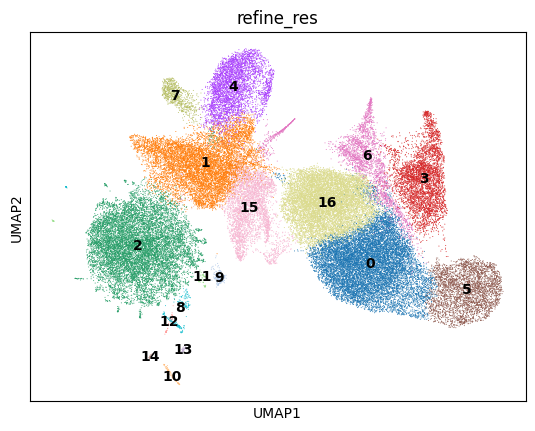

In [27]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [29]:
clustering_label = 'refine_res'

In [30]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

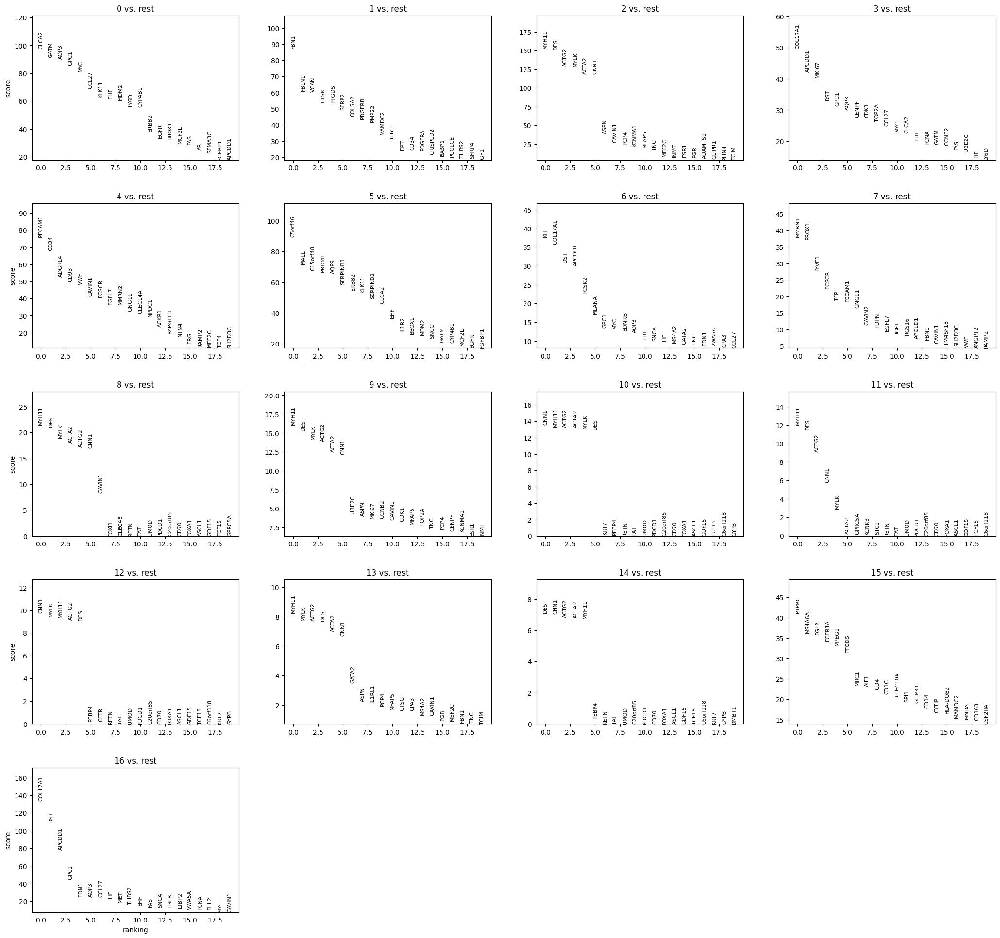

In [31]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [32]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [33]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

In [34]:
adata_cells.obs.loc[adata_cells.obs['refine_res'].isin(['8', '9', '10', '11', '12', '13', '14']), 'label1'] = 'Unknown'
adata_cells.obs.loc[adata_cells.obs['refine_res'].isin(['8', '9', '10', '11', '12', '13', '14']), 'label2'] = 'Unknown'

### 5.1. Cluster 0

In [35]:
cluster_id = '0'

In [36]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Keratinocyte,normal_cell,52.9
1,NA,NA,NA,39.7
2,Endothelial,Endothelial,normal_cell,2.5
3,Epithelial,Basal_keatinocyte,normal_cell,1.9
4,Mast,Mast,normal_cell,1.6


In [37]:
top_ranked_genes[cluster_id]

0    CLCA2
1     GATM
2     AQP3
3     GPC1
4      MYC
5    CCL27
6    KLK11
Name: 0, dtype: object

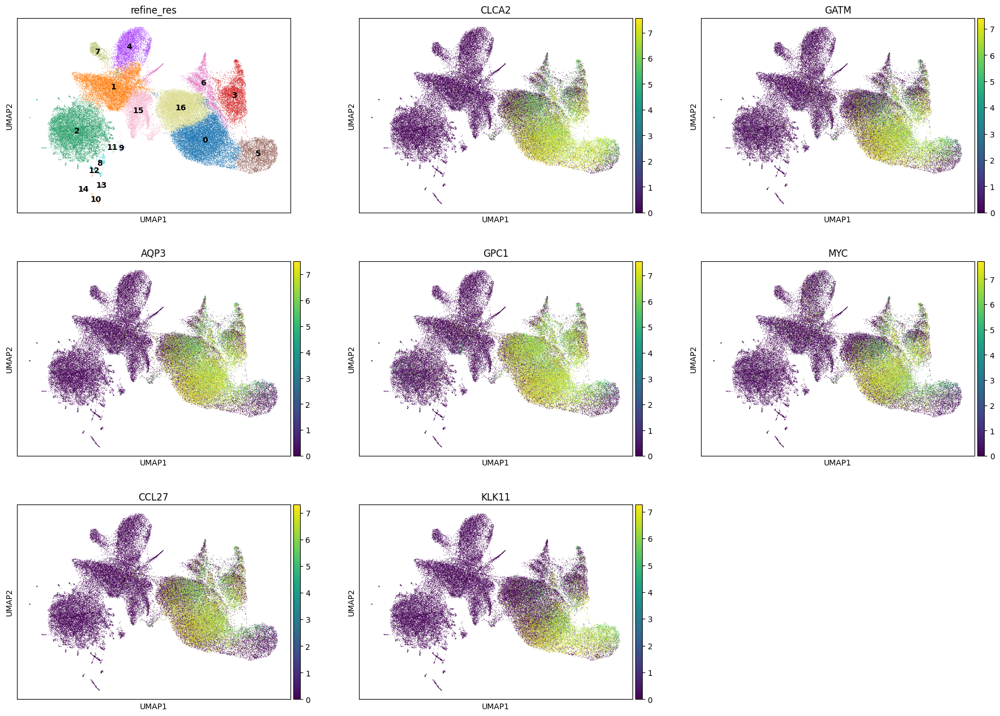

In [38]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [39]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 12302
Percentage of cells in cluster 0: 20.2


In [40]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Keratinocyte'

### 5.2. Cluster 1

In [41]:
cluster_id = '1'

In [42]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,76.2
1,Fibroblast,Fibroblast,normal_cell,22.1
2,Endothelial,Endothelial,normal_cell,0.6
3,Epithelial,Basal_keatinocyte,normal_cell,0.3
4,Smooth_muscle,Smooth_muscle,normal_cell,0.2


In [43]:
top_ranked_genes[cluster_id]

0      FBN1
1     FBLN1
2      VCAN
3      CTSK
4     PTGDS
5     SFRP2
6    COL5A2
Name: 1, dtype: object

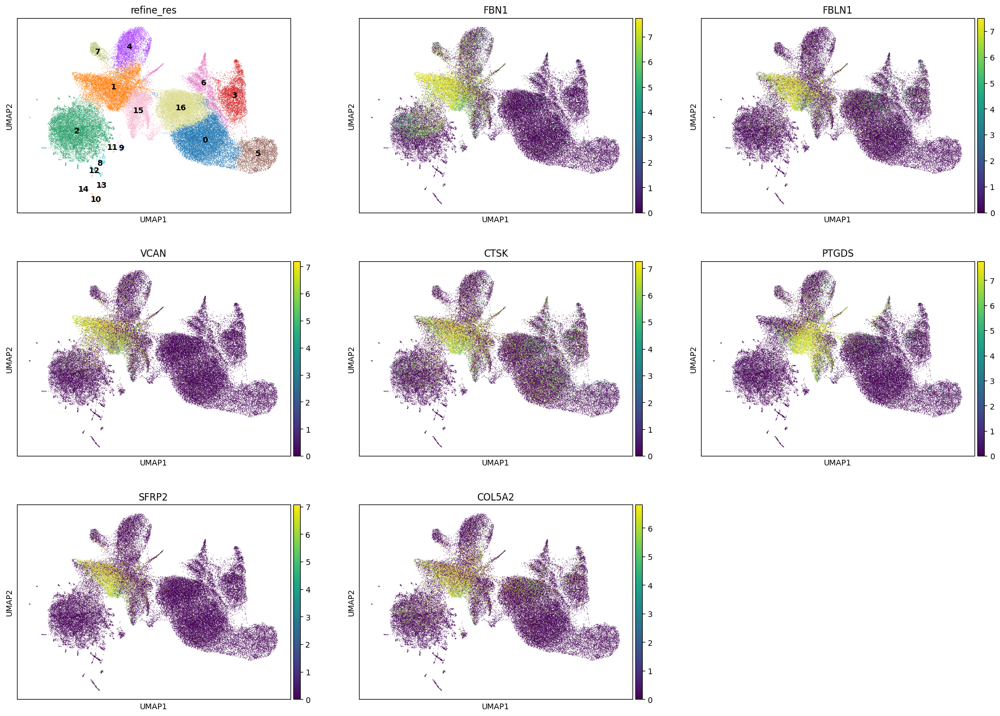

In [44]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [45]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 8719
Percentage of cells in cluster 1: 14.3


In [46]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.3. Cluster 2

In [47]:
cluster_id = '2'

In [48]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,90.0
1,Smooth_muscle,Smooth_muscle,normal_cell,9.8
2,Fibroblast,Fibroblast,normal_cell,0.1
3,Epithelial,Basal_keatinocyte,normal_cell,0.0
4,Epithelial,Keratinocyte,normal_cell,0.0


In [49]:
top_ranked_genes[cluster_id]

0    MYH11
1      DES
2    ACTG2
3     MYLK
4    ACTA2
5     CNN1
6     ASPN
Name: 2, dtype: object

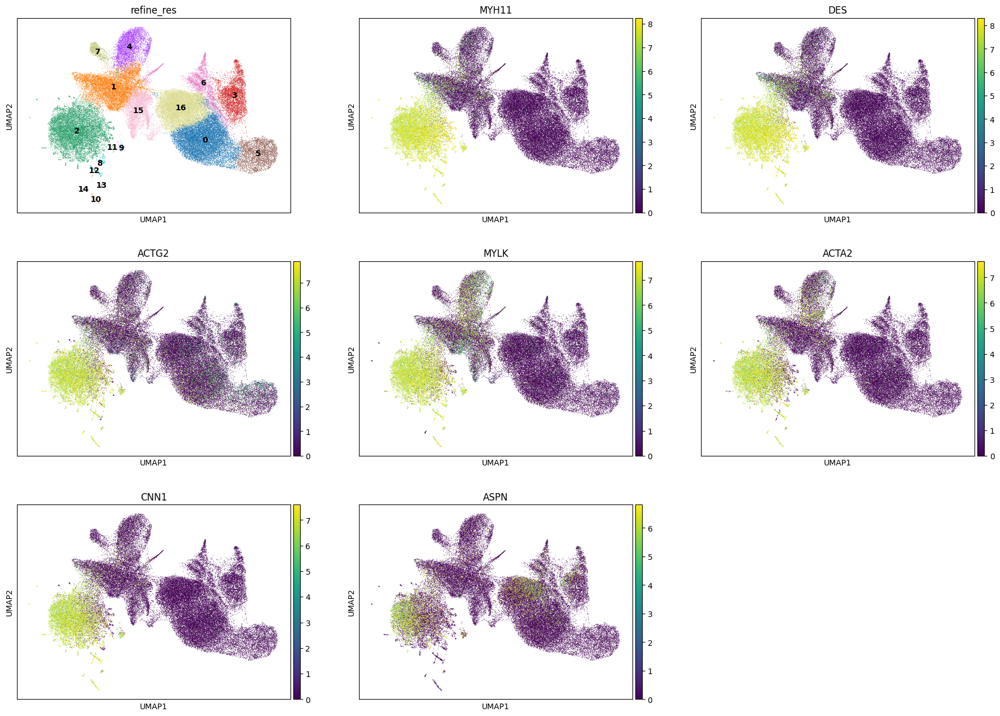

In [50]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [51]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 10842
Percentage of cells in cluster 2: 17.8


In [52]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Smooth_muscle'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Smooth_muscle'

### 5.4. Cluster 3

In [53]:
cluster_id = '3'

In [54]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Proliferating_basal_keratinocyte,normal_cell,52.6
1,NA,NA,NA,22.6
2,Epithelial,Basal_keatinocyte,normal_cell,11.0
3,Epithelial,Keratinocyte,normal_cell,8.1
4,Melanocyte,Melanocyte,normal_cell,2.2


In [55]:
top_ranked_genes[cluster_id]

0    COL17A1
1     APCDD1
2      MKI67
3        DST
4       GPC1
5       AQP3
6      CENPF
Name: 3, dtype: object

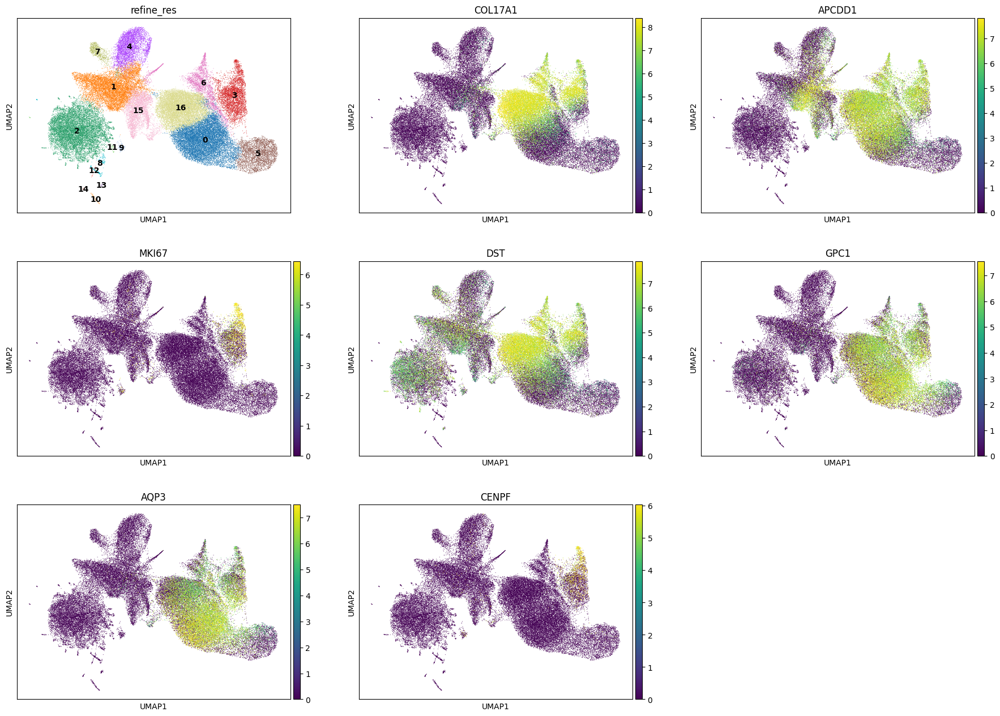

In [56]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [57]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 4314
Percentage of cells in cluster 3: 7.1


In [58]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Proliferating_basal_keratinocyte'

### 5.5. Cluster 4

In [59]:
cluster_id = '4'

In [60]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,57.4
1,Endothelial,Endothelial,normal_cell,40.3
2,Fibroblast,Fibroblast,normal_cell,1.6
3,Smooth_muscle,Smooth_muscle,normal_cell,0.3
4,Macrophage/DC,Macrophage/DC,normal_cell,0.1


In [61]:
top_ranked_genes[cluster_id]

0    PECAM1
1      CD34
2    ADGRL4
3      CD93
4       VWF
5    CAVIN1
6     ECSCR
Name: 4, dtype: object

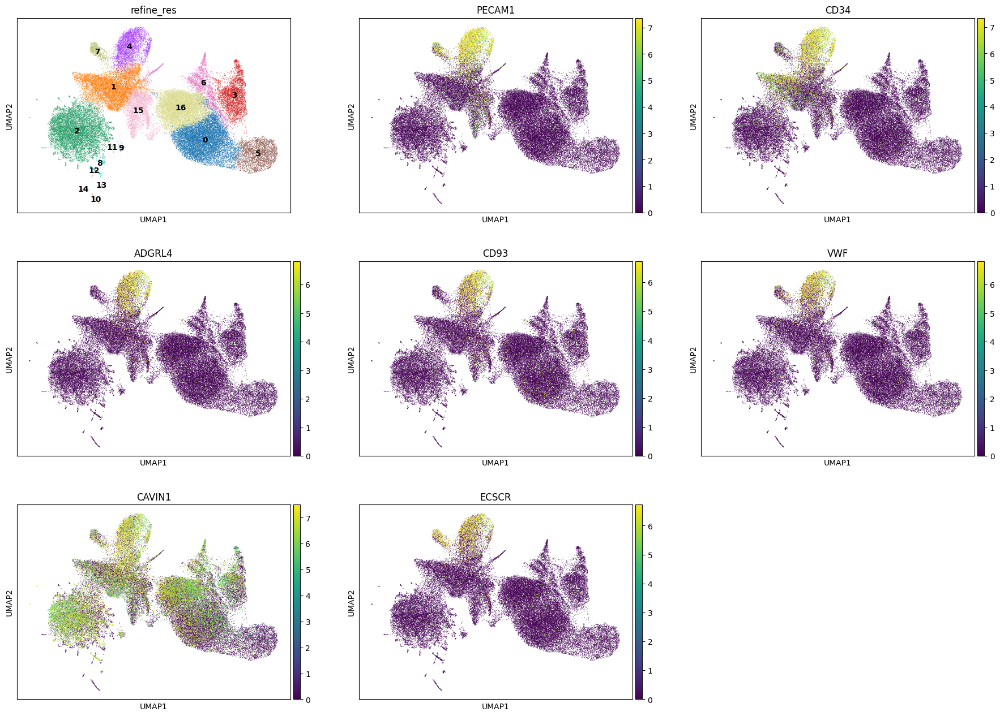

In [62]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [63]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 3954
Percentage of cells in cluster 4: 6.5


In [64]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.6. Cluster 5

In [65]:
cluster_id = '5'

In [66]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Keratinocyte,normal_cell,52.0
1,NA,NA,NA,45.2
2,Epithelial,Proliferating_basal_keratinocyte,normal_cell,1.2
3,Mast,Mast,normal_cell,0.9
4,Melanocyte,Melanocyte,normal_cell,0.3


In [67]:
top_ranked_genes[cluster_id]

0     C5orf46
1        MALL
2    C15orf48
3       PRDM1
4        AQP9
5    SERPINB3
6       ERBB2
Name: 5, dtype: object

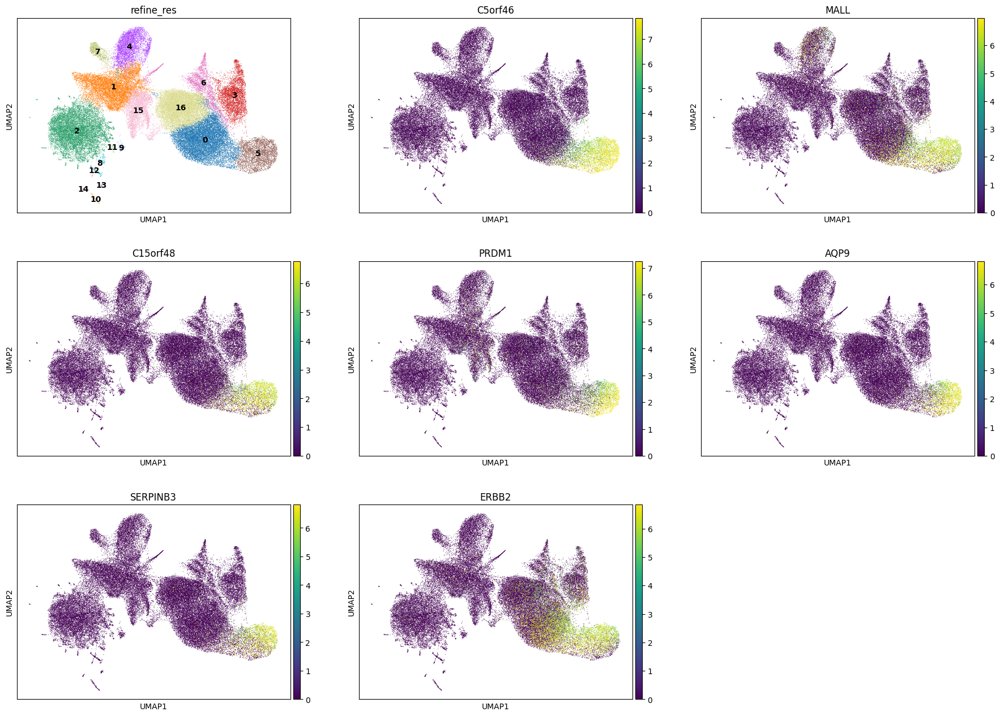

In [68]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [69]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 3194
Percentage of cells in cluster 5: 5.2


In [70]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Keratinocyte'

### 5.7. Cluster 6

In [71]:
cluster_id = '6'

In [72]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,33.2
1,Melanocyte,Melanocyte,normal_cell,29.4
2,Epithelial,Basal_keatinocyte,normal_cell,13.9
3,Mast,Mast,normal_cell,12.8
4,Epithelial,Keratinocyte,normal_cell,8.0


In [73]:
top_ranked_genes[cluster_id]

0        KIT
1    COL17A1
2        DST
3     APCDD1
4      PCSK2
5      MLANA
6       GPC1
Name: 6, dtype: object

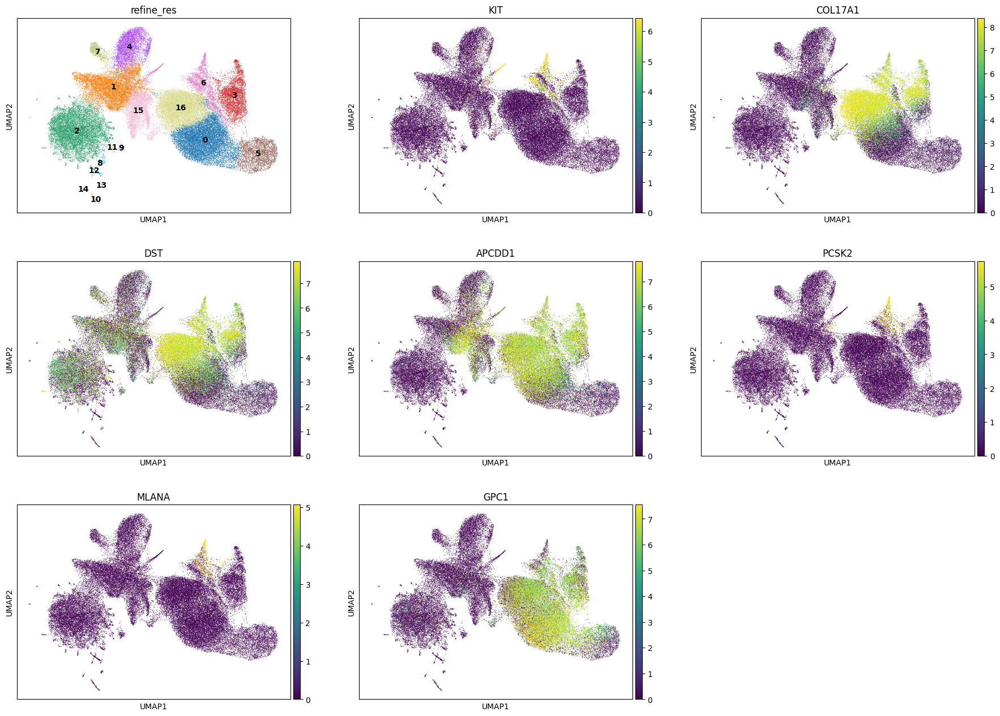

In [74]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [75]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 2778
Percentage of cells in cluster 6: 4.6


In [76]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Melanocyte'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Melanocyte'

### 5.8. Cluster 7

In [77]:
cluster_id = '7'

In [78]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,75.5
1,Endothelial,Endothelial,normal_cell,23.8
2,Fibroblast,Fibroblast,normal_cell,0.7


In [79]:
top_ranked_genes[cluster_id]

0     MMRN1
1     PROX1
2     LYVE1
3     ECSCR
4      TFPI
5    PECAM1
6     GNG11
Name: 7, dtype: object

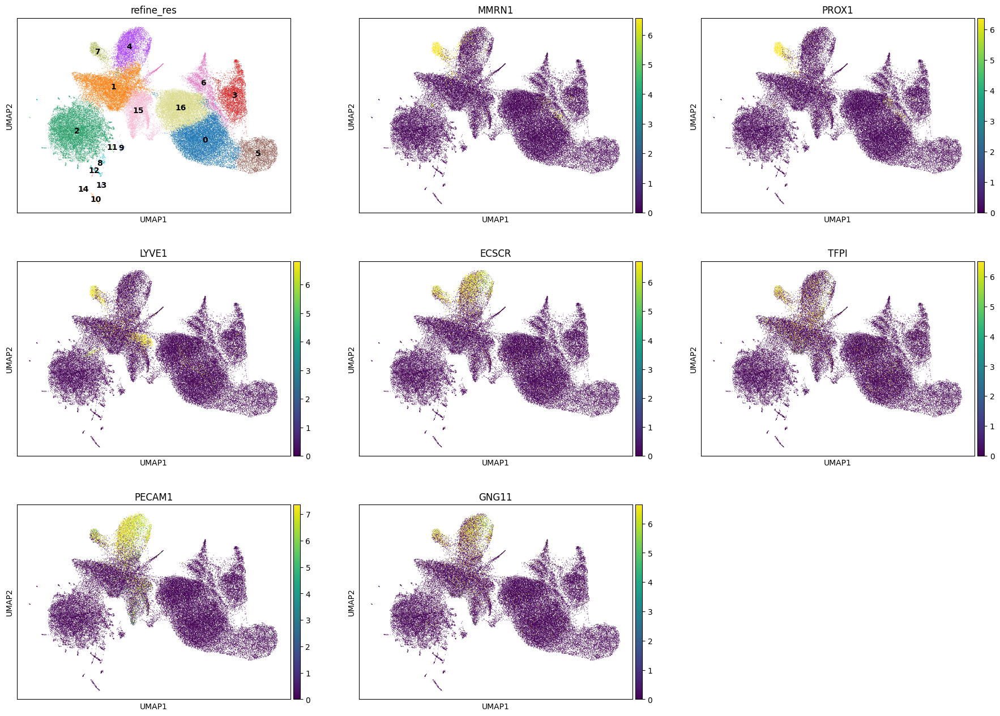

In [80]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [81]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 735
Percentage of cells in cluster 7: 1.2


In [82]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.9. Cluster 15

In [83]:
cluster_id = '15'

In [84]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,65.0
1,Macrophage/DC,Macrophage/DC,normal_cell,29.9
2,Fibroblast,Fibroblast,normal_cell,3.8
3,Epithelial,Basal_keatinocyte,normal_cell,0.5
4,Epithelial,Keratinocyte,normal_cell,0.2


In [85]:
top_ranked_genes[cluster_id]

0     PTPRC
1    MS4A6A
2      FGL2
3    FCER1A
4     MPEG1
5     PTGDS
6      MRC1
Name: 15, dtype: object

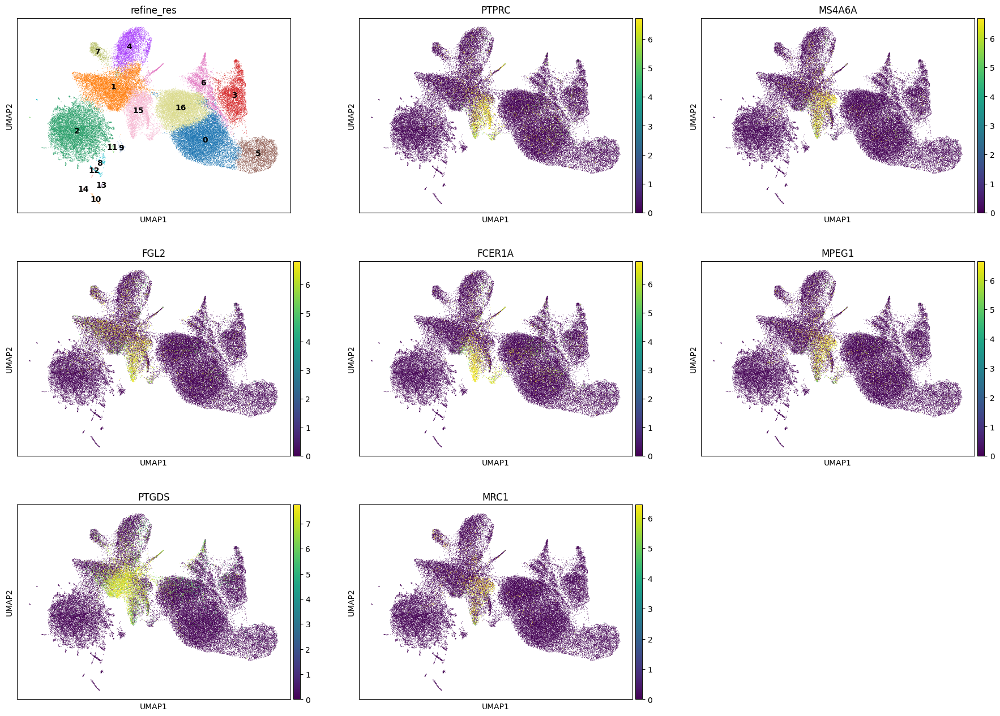

In [86]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [87]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 15: 3786
Percentage of cells in cluster 15: 6.2


In [88]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage/DC'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage/DC'

### 5.10. Cluster 16

In [89]:
cluster_id = '16'

In [90]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Basal_keatinocyte,normal_cell,52.4
1,NA,NA,NA,32.5
2,Epithelial,Keratinocyte,normal_cell,11.0
3,Mast,Mast,normal_cell,1.3
4,Endothelial,Endothelial,normal_cell,1.2


In [91]:
top_ranked_genes[cluster_id]

0    COL17A1
1        DST
2     APCDD1
3       GPC1
4       EDN1
5       AQP3
6      CCL27
Name: 16, dtype: object

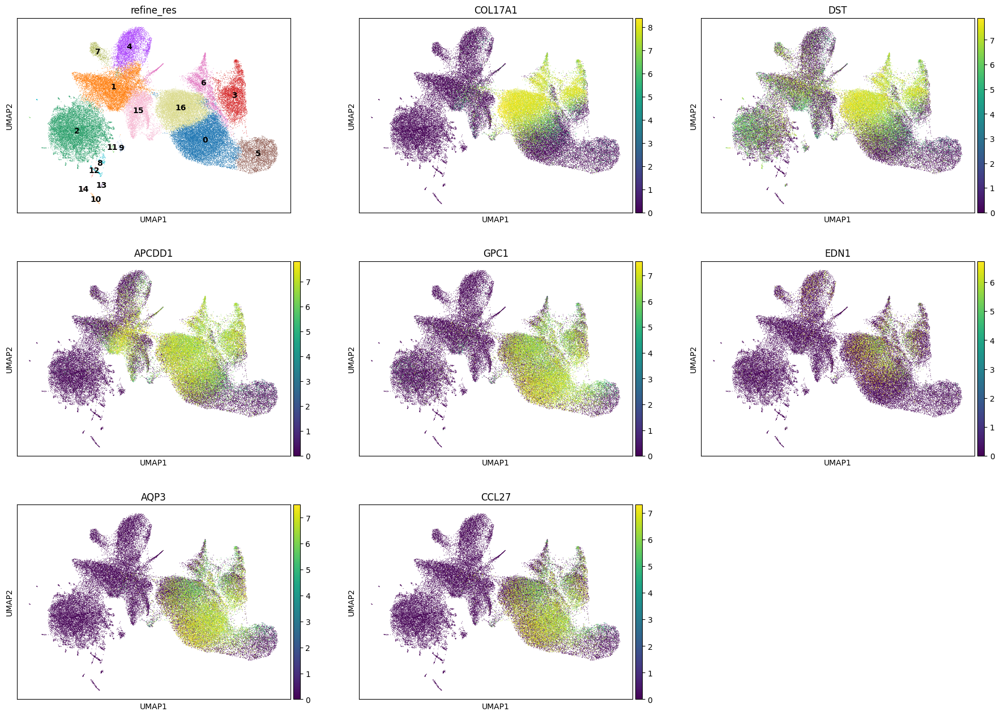

In [92]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [93]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 16: 9746
Percentage of cells in cluster 16: 16.0


In [94]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Keratinocyte'

## 6. Cancer cells

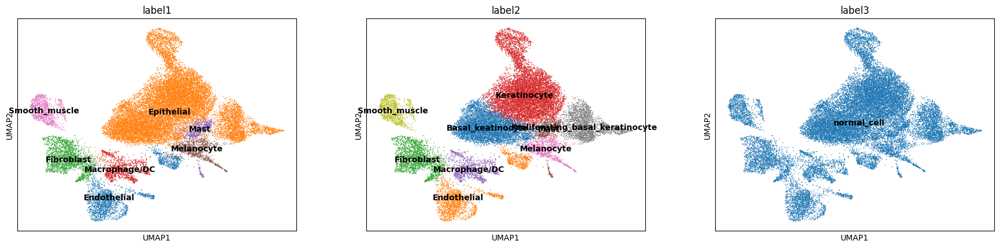

In [95]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

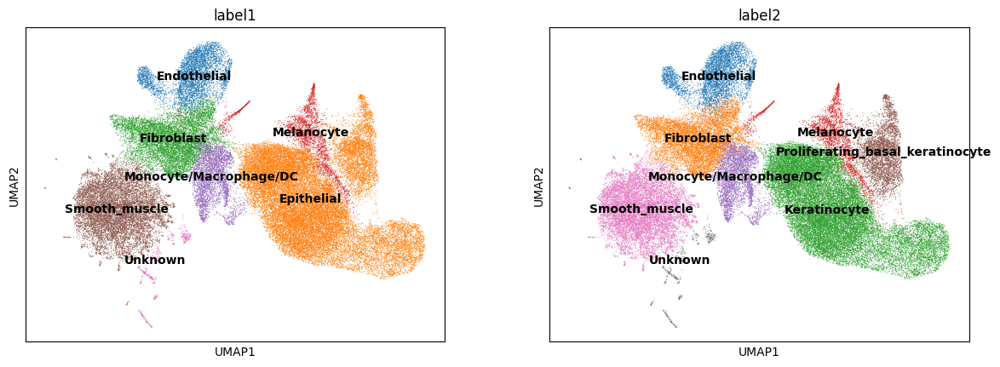

In [96]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [97]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'

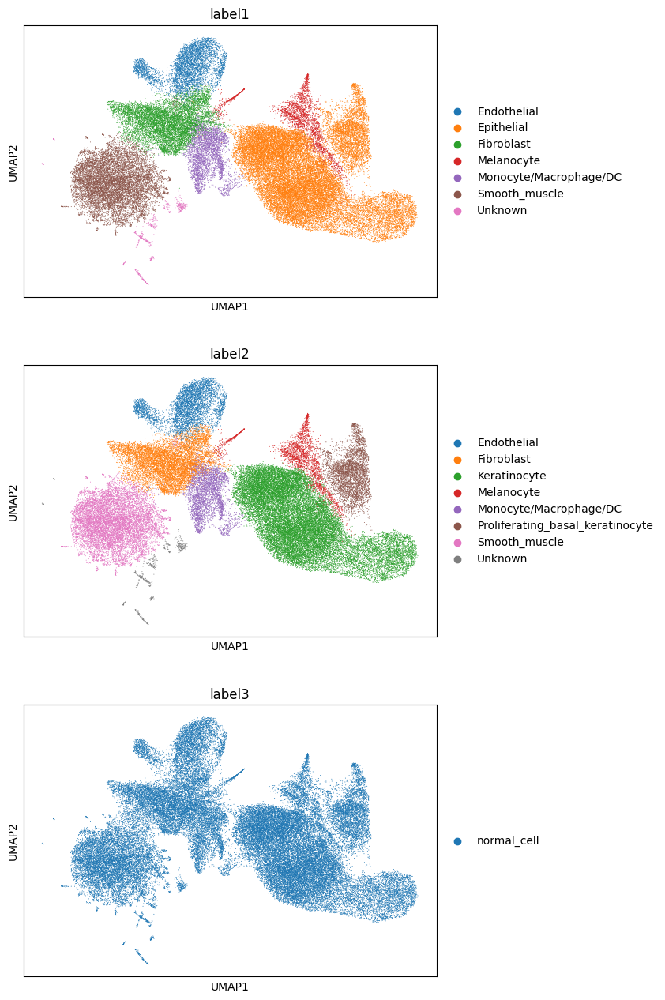

In [98]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [99]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,18,1,0,0,0,19,407.264234,42.627502,cell_labels,5,7,6,5,Epithelial,Keratinocyte,normal_cell
1,aaaaaaab-1,26,0,0,0,0,26,113.477660,42.492033,cell_labels,0,0,0,0,Epithelial,Keratinocyte,normal_cell
2,aaaaaaac-1,26,0,0,0,0,26,151.725006,78.120315,cell_labels,3,5,5,3,Epithelial,Proliferating_basal_keratinocyte,normal_cell
3,aaaaaaad-1,16,0,0,0,0,16,66.063596,22.713595,cell_labels,0,2,2,16,Epithelial,Keratinocyte,normal_cell
5,aaaaaaaf-1,23,0,0,0,0,23,103.091722,51.839377,cell_labels,0,0,0,0,Epithelial,Keratinocyte,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90099,aaabfppd-1,57,0,0,0,0,57,301.192198,29.306407,cell_labels,5,7,6,5,Epithelial,Keratinocyte,normal_cell
90101,aaabfppf-1,17,0,0,0,0,17,73.153128,36.395939,cell_labels,0,0,0,0,Epithelial,Keratinocyte,normal_cell
90102,aaabfppg-1,23,0,0,0,0,23,318.983762,10.566563,cell_labels,5,7,6,5,Epithelial,Keratinocyte,normal_cell
90103,aaabfpph-1,36,0,0,0,0,36,432.822672,19.868751,cell_labels,5,7,6,5,Epithelial,Keratinocyte,normal_cell


In [100]:
adata_cells.write_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")